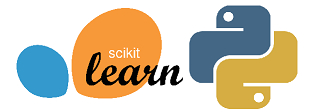

# Regresión Lineal con Python

Tu vecina es un agente de bienes raíces y quiere ayuda para predecir los precios de la vivienda en las regiones de EE. UU. Sería genial si de alguna manera pudieras crear un modelo para ella que le permitiera poner algunas características de una casa y devolver una estimación del precio en la que se vendería.

Ella te ha preguntado si podrías ayudarla con tus nuevas habilidades en Ciencia de Datos. ¡Tu le dices que sí y decides que la regresión lineal podría ser un buen camino para resolver este problema!

Entonces, tu vecina te brinda información sobre un grupo de casas en regiones de los Estados Unidos, todo está en el conjunto de datos: USA_Housing.csv.

Los datos contienen las siguientes columnas:

* '**Avg. Area Income**': Promedio de los ingresos de los residentes de la ciudad donde se encuentra la casa.
* '**Avg. Area House Age**': Promedio de edad de la casa en el area donde se encuentra.
* '**Avg. Area Number of Rooms**': Promedio de numero de habitaciones para casas en la misma ciudad.
* '**Avg. Area Number of Bedrooms**': Promedio de numero de habitaciones para casas en la misma ciudad.
* '**Area Population**': Poblacion de la ciudad donde se encuentra ubicada la casa.
* '**Price**': Precio al que se vendió la casa.
* '**Address**': Direccion de la casa.

**Empecemos!**
## Revisemos los datos
Hemos podido obtener algunos datos de tu vecina para los precios de la viviendas, en un archivo de tipo csv, ¡preparemos nuestro entorno con las librerias que necesitaremos y luego importemos los datos!
### Importar Librerias

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

### Carga de los datos

In [2]:
USAhousing = pd.read_csv('USA_Housing.csv')

In [3]:
USAhousing.head()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price,Address
0,79545.458574,5.682861,7.009188,4.09,23086.800503,1.059034e+06,"208 Michael Ferry Apt. 674\nLaurabury, NE 3701..."
1,79248.642455,6.002900,6.730821,3.09,40173.072174,1.505891e+06,"188 Johnson Views Suite 079\nLake Kathleen, CA..."
2,61287.067179,5.865890,8.512727,5.13,36882.159400,1.058988e+06,"9127 Elizabeth Stravenue\nDanieltown, WI 06482..."
3,63345.240046,7.188236,5.586729,3.26,34310.242831,1.260617e+06,USS Barnett\nFPO AP 44820
4,59982.197226,5.040555,7.839388,4.23,26354.109472,6.309435e+05,USNS Raymond\nFPO AE 09386


In [4]:
USAhousing.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5000 entries, 0 to 4999
Data columns (total 7 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Avg. Area Income              5000 non-null   float64
 1   Avg. Area House Age           5000 non-null   float64
 2   Avg. Area Number of Rooms     5000 non-null   float64
 3   Avg. Area Number of Bedrooms  5000 non-null   float64
 4   Area Population               5000 non-null   float64
 5   Price                         5000 non-null   float64
 6   Address                       5000 non-null   object 
dtypes: float64(6), object(1)
memory usage: 273.6+ KB


In [5]:
USAhousing.describe()

,Avg. Area Income,Avg. Area House Age,Avg. Area Number of Rooms,Avg. Area Number of Bedrooms,Area Population,Price
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5.000000e+03
mean,68583.108984,5.977222,6.987792,3.981330,36163.516039,1.232073e+06
std,10657.991214,0.991456,1.005833,1.234137,9925.650114,3.531176e+05
min,17796.631190,2.644304,3.236194,2.000000,172.610686,1.593866e+04
25%,61480.562388,5.322283,6.299250,3.140000,29403.928702,9.975771e+05
50%,68804.286404,5.970429,7.002902,4.050000,36199.406689,1.232669e+06
75%,75783.338666,6.650808,7.665871,4.490000,42861.290769,1.471210e+06
max,107701.748378,9.519088,10.759588,6.500000,69621.713378,2.469066e+06


In [6]:
USAhousing.columns

Index(['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
       'Avg. Area Number of Bedrooms', 'Area Population', 'Price', 'Address'],
      dtype='object')

# Análisis exploratorio de los datos (EDA)

¡Creemos algunos gráficos simples para verificar los datos!

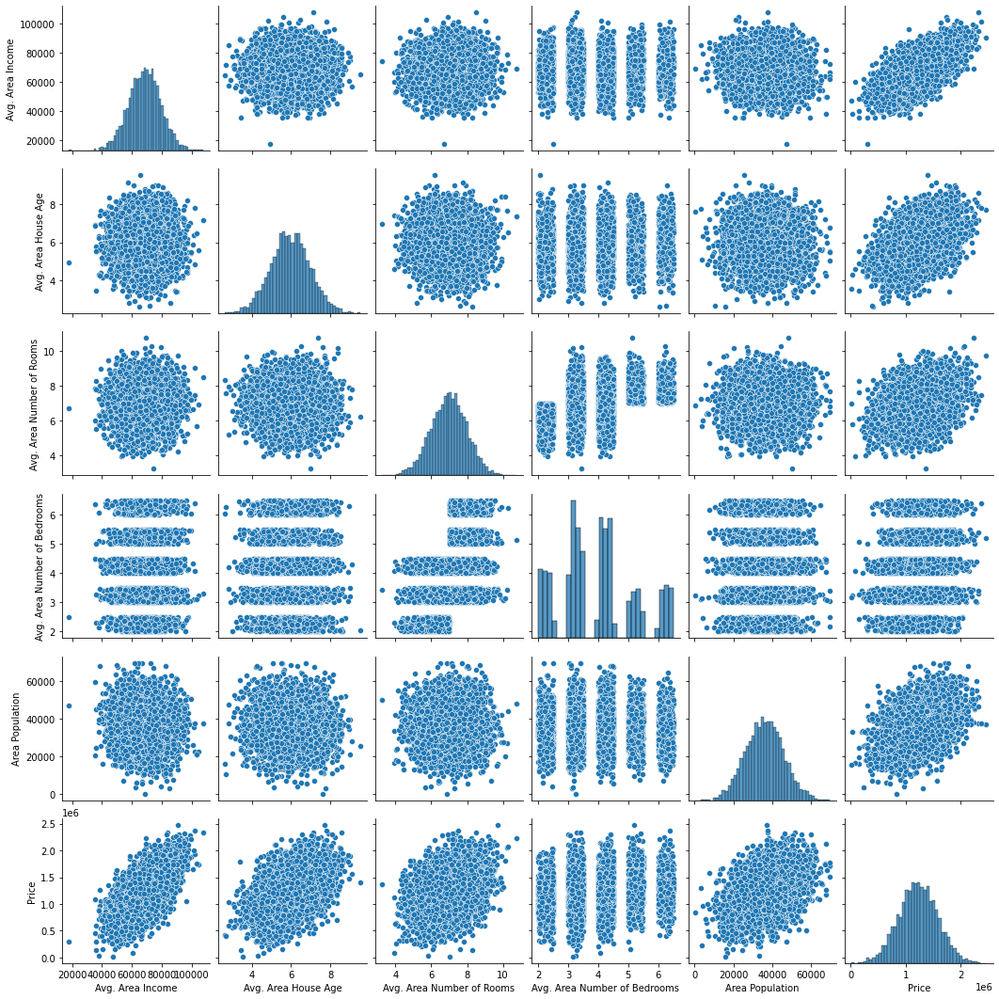

In [7]:
sns.pairplot(USAhousing)

<AxesSubplot:xlabel='Price', ylabel='Count'>

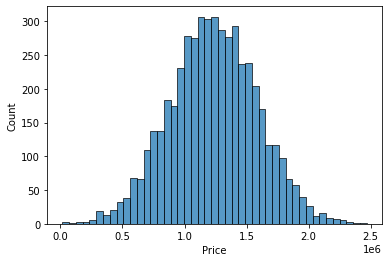

In [8]:
sns.histplot(USAhousing['Price'])

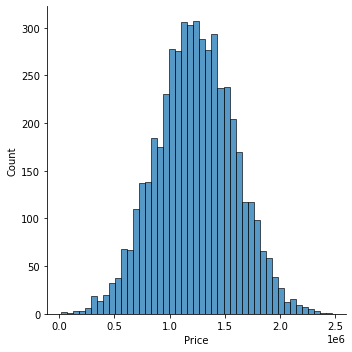

In [9]:
sns.displot(USAhousing['Price'])

<AxesSubplot:>

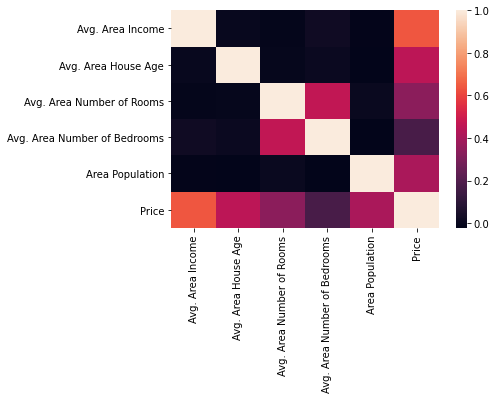

In [10]:
sns.heatmap(USAhousing.corr())

## Objetivo de la Regresión Lineal

El objetivo con la Regresión Lineal es minimizar la distancia vertical entre todos los datos y nuestra línea, por lo tanto, para determinar la mejor línea, debemos minimizar la distancia entre todos los puntos y la distancia de nuestra línea.  Existen muchos métodos para cumplir con este objetivo, pero todos estos métodos tienen un solo objetivo que es el de minimizar la distancia.

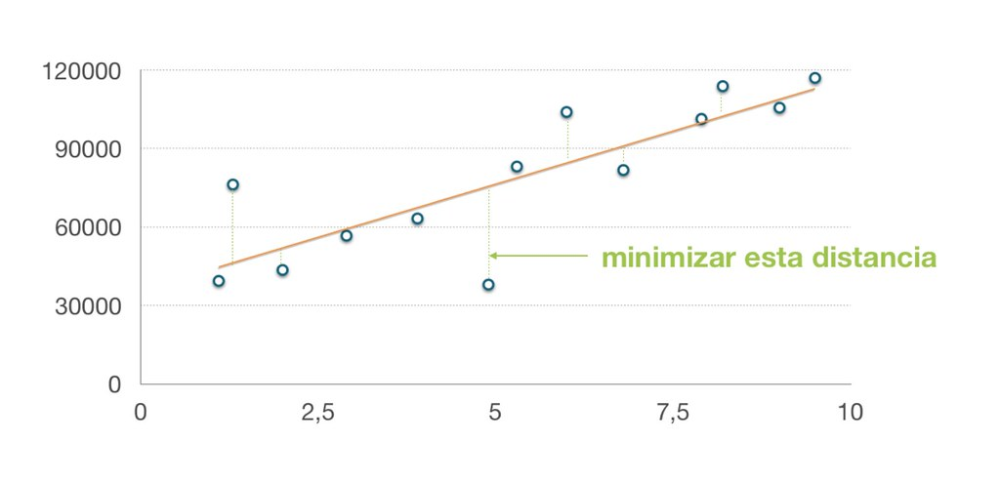


## Entrenamiento de un modelo de regresión lineal

¡Comencemos ahora a entrenar el modelo de regresión! Primero necesitaremos dividir nuestros datos en una matriz **X** que contenga las características para entrenar, y una matriz **y** con la variable de destino, en este caso la columna **Precio**. No consideramos la columna Dirección porque solo tiene información de texto que el modelo de regresión lineal no puede usar.

Con este modelo comprobaremos si existe una relación entre las variables de entradas y la de salida, luego, intentaremos predecir el valor de la variable de salida en función de nuestra variable de entrada.

### Matrices X e y 

Intentaremos explicar el comportamiento de una variable a partir de los datos de otras variables.

A la variable objeto de estudio se la denomina variable de salida o de respuesta: **y** 

A las variables que nos ayudarán en el estudio se las llama variables de entrada, explicativas o predictoras: **X**

In [11]:
X = USAhousing[['Avg. Area Income', 'Avg. Area House Age', 'Avg. Area Number of Rooms',
               'Avg. Area Number of Bedrooms', 'Area Population']]
y = USAhousing['Price']

## Obtener conjunto de datos de Entrenamiento (Train) y de Prueba (Test)

Ahora dividimos los datos en un conjunto de entrenamiento y un conjunto de prueba. Entrenaremos el modelo en el conjunto de entrenamiento y luego usaremos el conjunto de prueba para evaluar el modelo.

In [ ]:
import sys
!{sys.executable} -m pip install sklearn

In [13]:
from sklearn.model_selection import train_test_split

In [14]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=101)

## Creando y Entrenando el Modelo

In [15]:
# Usaremos el modelo LinearRegression del módulo linear_model de sklearn
from sklearn.linear_model import LinearRegression

In [16]:
# Creamos una instancia del modelo en la variable lm
lm = LinearRegression()

In [18]:
# Entrenamos (ajustamos) el modelo con los datos de entrenamiento
lm.fit(X_train,y_train)

LinearRegression()

## Evaluación del Modelo

Evaluemos el modelo comprobando sus coeficientes y cómo podemos interpretarlos.  Analicemos la siguiente imagen:

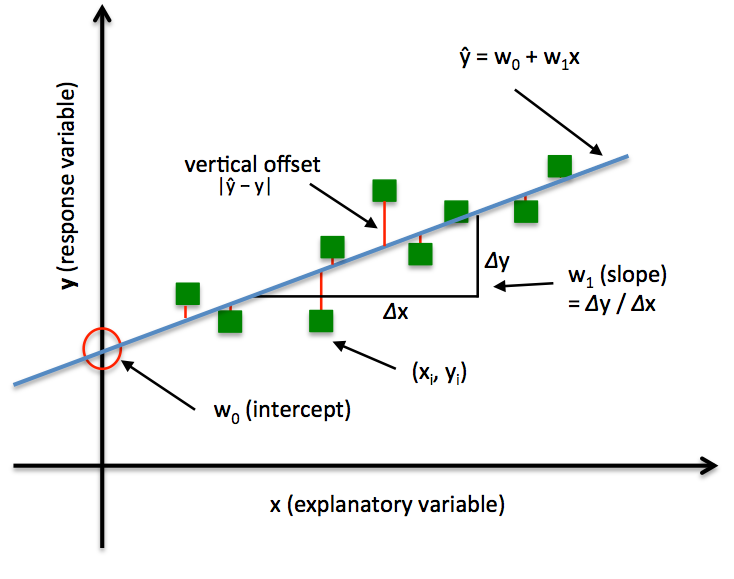

* x : variable de entrada.
* w0: término independiente (**intercept**). Valor de **y** cuando **x** es nulo.
* w1: pendiente de la recta (**slope**). Cuánto crece **y** cuando **x** sufre un cambio.
* y : variable de salida.
* ε : error.


Le pedimos al modelo la pendiente (w1) y el término independiente de la recta (w0)

In [19]:
# visualicemos la intersección -> intercept -> w0 = valor de y cuando x es nulo

slope = lm.coef_  # w1
intercept = lm.intercept_ # w0

print("Las pendientes 'w1' del modelo son: ", slope)
print("El término independiente de la recta 'w0' es: ", intercept)

Las pendientes 'w1' del modelo son:  [2.15282755e+01 1.64883282e+05 1.22368678e+05 2.23380186e+03
 1.51504200e+01]
El término independiente de la recta 'w0' es:  -2640159.7968526953


In [25]:
# Creamos un nuevo dataframe teniendo una unica columna llamada coeficiente obtenido para cada variable o atributo evaluado en 
# el modelo
# El coeficiente calculado es W1 -> Cuánto crece "y" cuando "x" sufre un cambio.
coef_df = pd.DataFrame(lm.coef_,X.columns,columns=['Coeficiente'])
coef_df

,Coeficiente
Avg. Area Income,21.528276
Avg. Area House Age,164883.282027
Avg. Area Number of Rooms,122368.678027
Avg. Area Number of Bedrooms,2233.801864
Area Population,15.150420


Interpretación de los coeficientes obtenidos:

- Manteniendo todas las demás características fijas, un aumento de 1 unidad en **Avg. Area Income** está asociado con un **incremento de $ 21.52** en el precio de la vivienda.

- Manteniendo todas las demás características fijas, un aumento de 1 unidad en **Avg. Area House Age** está asociado con un **incremento de $ 164883.28** en el precio de la vivienda.

- Manteniendo todas las demás características fijas, un aumento de 1 unidad en **Avg. Area Number of Bedrooms**  está asociado con un **incremento de $ 122368.67** en el precio de la vivienda.

- Manteniendo todas las demás características fijas, un aumento de 1 unidad en **Avg. Area Number of Bedrooms** está asociado con un **incremento de $ 2233.80** en el precio de la vivienda.

- Manteniendo todas las demás características fijas, un aumento de 1 unidad en **Area Population** se asocia con un **aumento de $ 15.15** en el precio de la vivienda.

¿Esto tiene sentido? Probablemente no, porque estos datos son inventados. Si deseas datos reales repite este tipo de análisis, a partir del [conjunto de datos de Boston] (http://scikit-learn.org/stable/modules/generated/sklearn.datasets.load_boston.html):

    from sklearn.datasets import load_boston
    boston = load_boston()
    print(boston.DESCR)
    boston_df = boston.data

## Predicciones de nuestro Modelo

Lo veremos en la siguiente practica (Parte 2)

## Métricas de evaluación de regresión

Lo veremos en la siguiente practica (Parte 2)

## Buen trabajo!